# STRATEGIC IMPLEMENTATION OF ARTIFICIAL INTELLIGENCE IN DIAGNOSING LARYNGEAL DISEASE

## 1. Objective
Voice disorders affect millions globally, with early differentiation between benign and malignant laryngeal pathologies being critical for patient outcomes. Traditional diagnostic methods like laryngoscopy are invasive and require specialized expertise.

### Technical Problem Statement
Develop a non-invasive intelligent model using convolutional neural networks (CNNs) to classify laryngeal disorders as **benign** or **malignant** based on voice recordings.

### Defining KPIs

1. **Accuracy** :  The overall proportion of cases correctly classified by the model, both benign and malignant. Target accuracy > ??

$$\text{Accuracy} = \frac{\text{True Positives} + \text{True Negatives}}{\text{Total Cases}}$$



2. **Sensitivity** : The ability to correctly identify patients who have the disease (malignant cases); also called "True Positive Rate". Target sentivity > ??

$$\text{Sensitivity} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Negatives}}$$


3. **Specificity** : The ability to correctly identify healthy cases (benign); also called "True Negative Rate". Target specificity > ??

$$\text{Specificity} = \frac{\text{True Negatives}}{\text{True Negatives} + \text{False Positives}}$$


<br>
<div style="text-align: center">
<img src="images/confusion-matrix.jpg" alt="alt text">
</div>


## 2. Data Preparations and Audio Processing Pipeline

### Input Specifications 
<p>Audio files in classified into Benign and Malignant. Since we have variable length audio files in data we will trim the files into chunks of 5-10 secs long. Audio input should be fixed length, since neural networks need consistent input shapes and variable-length inputs can reduce accuracy and complicate preprocessing. For our calculations we would be assuming that <i>Benign</i> and <i>malignant</i> are represented by 0 and 1.</p>

<p>Lossless audio formats like wav simplify analysis and ensure compatibility so we will use a utility to convert input mp3 into wav. After converting the audio into wav format, we will normalise the input segments and load the data in data frame.</p>
After converting the format, we would be downsampling the audio chunks into 22.05kHz  to reduce computational load and to make deployment and feedback mechanism efficient. <br>
After resampling we would trim the data set into chunks of fixed length (5 secs) and we will filter chunks with silence by minimum acceptable Signal-to-Noise Ratio (SNR). <br>
We will also maintain patient's data in a seprate data frame.<br>


- Audio Format: MP3
- Target audio format: WAV
- Sampling Rate: 48kHz
- Target Sampleing Rate: 22050
- Duration - 5 secs
- Overlap Ratio - 50%
- Minimum SNR ration - 20 dB

In [21]:
import os
import glob
import librosa
import numpy as np
import pandas as pd
from scipy import signal
from pydub import AudioSegment


# defining configurations
TARGET_SAMPLING_RATE = 22050
DURATION = 5                    # Chunk duration
OVERLAP_RATIO = 0.5            # Overlap ratio
# MIN_RMS_VALUE = 0.05           # loudness threshold


CONFIG = {
    'target_sr': 22050,
    'duration': 5,
    'chunk_length': 5,
    'overlap_ratio': 0.5,
    'min_snr_ratio': 20,
    'data_dir': '/Users/mudi/voice-model/data/'
}

class AudioProcessor:

    def __init__(self, target_sr, duration, chunk_length, overlap_ratio, min_snr_ratio):
        self.target_sr = target_sr
        self.duration = duration
        self.overlap_ratio = overlap_ratio
        self.min_snr_ratio = min_snr_ratio
        self.chunk_length = chunk_length
        self.overlap_length = overlap_ratio

    def load_audio(self, file_path):
        try:
            audio_data, sr = librosa.load(file_path, sr=self.target_sr)
            return audio_data, sr
        except Exception as e:
            print(f"Error while processing {file_path}: {e}")
            return None, None
    
    def normalize_audio(self, audio):
        pass
    
    """split audio into chunks of fixed duration with overlap"""
    def chunk_audio(self, audio):
        chunk_len = int(self.target_sr * self.duration)
        hop_len = int(chunk_len * (1 - self.overlap_ratio))

        chunks = []
        for start_idx in range(0, len(audio) - chunk_len + 1, hop_len):
            end_idx = start_idx + chunk_len
            chunk = audio[start_idx:end_idx]
            # ignore chunk if it has low energy (low RMS value)
            snr = self.calculate_snr(chunk)
            if snr >= self.min_snr_ratio:
                chunks.append({
                    'audio_data': chunk,
                    'rms': self.calculate_rms(chunk),
                    'snr': snr
                })
        return chunks

    def calculate_snr(self, audio):
        if len(audio) == 0:
            return -np.inf
        
        # Check if audio is all zeros
        if np.all(audio == 0):
            return -np.inf
        
        # Estimate noise as the minimum energy in short windows
        window_size = int(0.1 * self.target_sr)  # 100ms windows
        if len(audio) < window_size:
            # For very short audio, use simple RMS-based SNR
            rms = np.sqrt(np.mean(audio ** 2))
            if rms == 0:
                return -np.inf
            return 20 * np.log10(rms + 1e-12)
        
        # Calculate RMS in windows
        rms_values = []
        for i in range(0, len(audio) - window_size + 1, window_size // 2):
            window = audio[i:i + window_size]
            rms = np.sqrt(np.mean(window ** 2))
            rms_values.append(rms)
        
        if not rms_values:
            return -np.inf
        
        rms_values = np.array(rms_values)
        
        # Handle edge case where we have very few RMS values
        if len(rms_values) < 5:
            signal_power = np.mean(rms_values)
            noise_power = np.min(rms_values)
        else:
            sorted_rms = np.sort(rms_values)
            n = len(sorted_rms)
            
            # Ensure we don't get empty arrays
            signal_start = max(1, int(0.2 * n))
            noise_end = max(1, int(0.2 * n))
            
            signal_power = np.mean(sorted_rms[signal_start:])
            noise_power = np.mean(sorted_rms[:noise_end])
        
        # Add small epsilon to avoid division by zero
        epsilon = 1e-12
        signal_power = max(signal_power, epsilon)
        noise_power = max(noise_power, epsilon)
        
        snr_db = 20 * np.log10(signal_power / noise_power)
        
        # Handle NaN or inf values
        if np.isnan(snr_db) or np.isinf(snr_db):
            return -np.inf
        
        return snr_db

    def calculate_rms(self, audio):
        """Normalize audio to [-1, 1] range"""
        max_val = np.max(np.abs(audio))
        if max_val == 0:
            return audio
        return audio / max_val

def load_dataset(data_dir):
    """
    Load and organize the dataset from Benign and Malignant folders
    """
    processor = AudioProcessor(CONFIG['target_sr'], 
                               CONFIG['duration'], 
                               CONFIG['chunk_length'], 
                               CONFIG['overlap_ratio'], 
                               CONFIG['min_snr_ratio'])
    dataset = []
    
    # Process Benign files
    benign_dir = os.path.join(data_dir, 'Benign')
    if os.path.exists(benign_dir):
        for patient_folder in os.listdir(benign_dir):
            patient_path = os.path.join(benign_dir, patient_folder)
            if os.path.isdir(patient_path):
                for audio_file in glob.glob(os.path.join(patient_path, '*.mp3')) + \
                                 glob.glob(os.path.join(patient_path, '*.wav')) + \
                                 glob.glob(os.path.join(patient_path, '*.m4a')):
                    
                    audio, sr = processor.load_audio(audio_file)
                    if audio is not None:
                        chunks = processor.chunk_audio(audio)
                        for chunk in chunks:
                            dataset.append({
                                'file_path': audio_file,
                                'patient_folder': patient_folder,
                                'label': 'benign',
                                'audio': chunk['audio_data'],
                                'snr_db': chunk['snr'],
                                'rms': chunk['rms']
                            })
    
    # Process Malignant files
    malignant_dir = os.path.join(data_dir, 'Malignant')
    if os.path.exists(malignant_dir):
        for patient_folder in os.listdir(malignant_dir):
            patient_path = os.path.join(malignant_dir, patient_folder)
            if os.path.isdir(patient_path):
                for audio_file in glob.glob(os.path.join(patient_path, '*.mp3')) + \
                                 glob.glob(os.path.join(patient_path, '*.wav')) + \
                                 glob.glob(os.path.join(patient_path, '*.m4a')):
                    
                    audio, sr = processor.load_audio(audio_file)
                    if audio is not None:
                        chunks = processor.chunk_audio(audio)
                        for chunk in chunks:
                            dataset.append({
                                'file_path': audio_file,
                                'patient_folder': patient_folder,
                                'label': 'malignant',
                                'audio': chunk['audio_data'],
                                'rms': chunk['rms'],
                                'snr_db': chunk['snr']
                            })
    
    return pd.DataFrame(dataset)

# # DEP: use librosa.util.normalize
# def normalize_audio(audio):
#     max_val = np.max(np.abs(audio))
#     if max_val == 0:
#         return audio
#     return audio / max_val

# def calculate_rms(audio):
#     rms = np.sqrt(np.mean(audio ** 2))
#     if rms == 0:
#         return float('inf')
#     return rms

# def convert_mp3_to_audio_segments(input_file):
#     try: 
#         # load mp3 data, downsample and normalize
#         audio_data, sr = librosa.load(input_file, sr=TARGET_SAMPLING_RATE, norm=False)
#         #audio_data = librosa.util.normalize(audio_data)

#         # segment audio
#         segments = []
#         segment_length = int(sr * DURATION)
#         hop_length = int(segment_length * (1 - OVERLAP_RATIO))

#         for start_idx in range(0 ,len(audio_data) - segment_length + 1, hop_length):
#             end_idx = start_idx + segment_length
#             segment = audio_data[start_idx:end_idx]
#             segments.append(segment)
#         return segments, sr
#     except Exception as e:
#         print(f"Error processing {input_file}: {e}")
#         return []

# def extract_patient_info(patient_dir):
#     patient_info = {
#         'name': None,
#         'age': None,
#         'gender': None,
#         'condition': None,
#     }

#     try:
#         parts = patient_dir.strip().split('-')

#         # name-age-gender-condition
#         patient_info['name'] = parts[0].strip()
#         age_str = parts[1].strip()
#         if age_str:
#             patient_info['age'] = int(age_str)
        
#         gender = parts[2].strip()
#         clean_gender = ''.join(filter(str.isalpha, gender)).lower()
#         if clean_gender in ['m', 'male']:
#             patient_info['gender'] = 'Male'
#         elif clean_gender in ['f', 'female']:
#             patient_info['gender'] = 'Female'
#         else:
#             patient_info['gender'] = None

#         if len(parts) > 3:
#             patient_info['condition'] = '-'.join(parts[3:]).strip()
    
#     except Exception as e:
#         print(f"Error extracting patient info from {patient_dir}: {e}") 
#     return patient_info
        

# def process_audio_file(file_path, input_dir):
#     try:
#         # extract patient info
#         relative_path = os.path.relpath(file_path, input_dir)
#         path_parts = relative_path.split(os.sep)
#         patient_folder = path_parts[1] if len(path_parts) > 1 else None
#         patient_info = extract_patient_info(patient_folder)

#         # determine class label - benign or malignant
#         class_label = path_parts[0] if len(path_parts) > 0 else None

#         # convert file to audio processable audio segments
#         audio_segments, sr = convert_mp3_to_audio_segments(file_path)
#         if len(audio_segments) == 0:
#             print(f"No audio segments found for {file_path}")
#             return []
#         # return records
#         records = []
#         for segment in audio_segments:
#             records.append(
#             {
#                 'path': relative_path,
#                 'label': class_label,
#                 'patient_age': patient_info['age'],
#                 'patient_gender': patient_info['gender'],
#                 'patient_condition': patient_info['condition'],
#                 'segment_size': len(segment),
#                 'audio_data': segment,
#                 'rms': calculate_rms(segment),
#                 'sampling_rate': sr
#             })
#         return records

#     except Exception as e:
#         print(f"Error processing {file_path}: {e}")
#         return None

# def clean_data(input_dir):
#     """Process all audio files in input directory"""
#     dataset = []
#     supported_formats = ['*.mp3', '*.wav', '*.m4a', '*.flac']

#     all_files = []
#     for ext in supported_formats:
#         pattern = os.path.join(input_dir, "**", ext)
#         all_files.extend(glob.glob(pattern, recursive=True))
    
#     # process individual files
#     for file_path in all_files:
#         try:
#             print(f"Processing {file_path}")
#             records = process_audio_file(file_path, input_dir)
#             if records and len(records) > 0:
#                 dataset.extend(records) 
#         except Exception as e:
#             print(f"Error processing {file_path}: {e}")
#             continue
    
#     # create dataframe for processed segmentated data
#     if dataset:
#         df = pd.DataFrame(dataset)
#         print(f"processed {len(df)} segments")
#         return df
#     else:
#         print("No data to process")
#         return pd.DataFrame()


# process files in unclean directory
data_dir = '/Users/mudi/voice-model/data/'
processed_data = load_dataset(data_dir)

processed_data.head(5)




Note: Illegal Audio-MPEG-Header 0x3139392c at offset 2412480.
Note: Trying to resync...
Note: Skipped 1024 bytes in input.
[src/libmpg123/parse.c:wetwork():1349] error: Giving up resync after 1024 bytes - your stream is not nice... (maybe increasing resync limit could help).
/var/folders/sd/zywz_szx6rd500k_lds9thtr0000gn/T/ipykernel_37619/3617741602.py:38: UserWarning: PySoundFile failed. Trying audioread instead.
  audio_data, sr = librosa.load(file_path, sr=self.target_sr)
/Users/mudi/voice-model/venv/lib/python3.9/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
Note: Illegal Audio-MPEG-Header 0x382c3231 at offset 3636480.
Note: Trying to resync...
Note: Skipped 1024 bytes in input.
[src/libmpg123/parse.c:wetwork():1349] error: Giving up resync after 1024 bytes - your stream is not nice... (m

,file_path,patient_folder,label,audio,snr_db,rms
0,/Users/mudi/voice-model/data/Benign/Satish-35-...,Satish-35-M-Right VC polyp,benign,"[-1.8309034e-05, -3.8822916e-05, 1.5410993e-05...",21.849525,"[-2.0695183e-05, -4.3882563e-05, 1.741945e-05,..."
1,/Users/mudi/voice-model/data/Benign/Satish-35-...,Satish-35-M-Right VC polyp,benign,"[-0.02481474, -0.024862424, -0.02341692, -0.02...",25.193588,"[-0.026549637, -0.026600653, -0.02505409, -0.0..."
2,/Users/mudi/voice-model/data/Benign/Satish-35-...,Satish-35-M-Right VC polyp,benign,"[-0.0038468456, -0.0018984018, 5.784126e-05, 0...",25.960621,"[-0.004115794, -0.0020311265, 6.188517e-05, 0...."
3,/Users/mudi/voice-model/data/Benign/Satish-35-...,Satish-35-M-Right VC polyp,benign,"[-0.31573066, -0.37858823, -0.43311825, -0.477...",22.214493,"[-0.34749225, -0.4166731, -0.47668868, -0.5254..."
4,/Users/mudi/voice-model/data/Benign/Satish-35-...,Satish-35-M-Right VC polyp,benign,"[-0.02284368, -0.018866554, -0.0049962313, 0.0...",25.870646,"[-0.0245185, -0.020249784, -0.0053625377, 0.01..."


In [23]:
print("dataset shape: ", processed_data.shape)
print("columns in dataset: ", processed_data.columns)

print(processed_data['snr_db'].isna().sum())

#print(processed_data.head(1))

dataset shape:  (416, 6)
columns in dataset:  Index(['file_path', 'patient_folder', 'label', 'audio', 'snr_db', 'rms'], dtype='object')
0


How to filter silence / low energy bands?
- RMS measures loudness (energy) of a signal.
- Silent or background-only segments have very low RMS values.
- Speech/voice segments have noticeably higher RMS values.

Key findings from plotting rms value of audio signals
- Silent/low-energy segments clustered around 0.0–0.05.
- Speech segments distributed above 0.05.

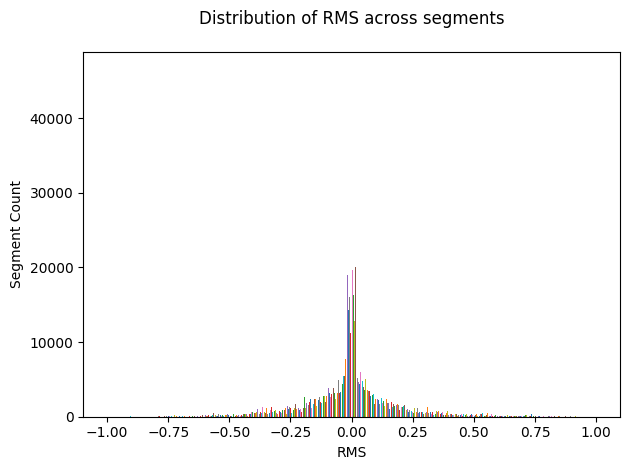

In [24]:
import matplotlib.pyplot as plt

rms_values = processed_data['rms'].dropna().values

plt.hist(rms_values, bins=100)
plt.xlabel("RMS")
plt.ylabel("Segment Count")
plt.title("Distribution of RMS across segments", pad=20)
plt.tight_layout()
plt.show()

In [67]:
# filter out low energy segments
print(MIN_RMS_VALUE)

raw_data = processed_data[processed_data['rms'] >= MIN_RMS_VALUE]
print("raw data shape: ", raw_data.shape, "\n")
# validations
null_counts = raw_data.isnull().sum()
print("null counts: \n", null_counts, "\n")


segment_sizes = raw_data['segment_size'].value_counts()
print(segment_sizes, "\n")




0.05
raw data shape:  (1931, 9) 

null counts: 
 path                 0
label                0
patient_age          0
patient_gender       0
patient_condition    0
segment_size         0
audio_data           0
rms                  0
sampling_rate        0
dtype: int64 

segment_size
110250    1931
Name: count, dtype: int64 



## FEATURE ENGINEERING ON AUDIO SEGMENTS

Feature engineering is done to extract objective, reproducible acoustic markers from 5-second, preprocessed and normalized voice samples. These acoustic features allow for automated differentiation between benign and malignant laryngeal disorders, complementing clinical evaluation. <br>
Based on the shared study we would be extracting the following features from each audio segments
 the following features are selected for engineering and model input:

- **Root Mean Square (RMS) Amplitude:** Quantifies loudness of each segment (already included in dataset). This reflects overall vocal energy and is sensitive to pathological voice changes.

- **Pitch-Related Features:** Fundamental frequency (F0, including max, median, and range) captures changes in vocal fold vibration, vital for detecting malignancy-linked vibratory restriction.

- **Perturbation Measures:** Jitter and shimmer (with APQ subtypes) quantify cycle-to-cycle instability in pitch and amplitude, indicating irregular vocal fold oscillation, a hallmark of malignancy.

- **Cepstral Peak Prominence (CPP):** Measures clarity and periodicity of voice, strongly associated with voice quality and dysphonia severity.

- **Spectral Features:** Low-frequency LTAS (0-1 kHz) reflects distribution of harmonic energy, typically reduced in malignant voices. Additional features may include spectral centroid, flatness, and formant frequencies for in-depth analysis.





In [82]:
from scipy import signal
from scipy.stats import skew, kurtosis, pearsonr, spearmanr
import warnings
import seaborn as sns
from sklearn.preprocessing import StandardScaler

warnings.filterwarnings('ignore')

def extract_fundamental_frequency(audio_data, sampling_rate):
    try:
        # compute f0 using librosa
        f0, voiced_flag, voiced_probs = librosa.pyin(
            y=audio_data,
            fmin=librosa.note_to_hz('C2'),
            fmax=librosa.note_to_hz('C7'),
            sr=sampling_rate
        )
    except Exception as e:
        print(f"Error extracting fundamental frequency: {e}")
        return None
    
    # handle edge cases
    if f0 is None:
        return None
    pass

processed_data['f0'] = extract_fundamental_frequency(audio_data=processed_data['audio_data'], sampling_rate= processed_data['sampling_rate'])
processed_data.head(5)

print(processed_data['audio_data'][0])

sample_f0 = extract_fundamental_frequency(audio_data = processed_data['audio_data'][0], sampling_rate= processed_data['sampling_rate'][0])
print(sample_f0)

processed_data.head(5)
processed_data.loc[:, 'rms'].mean()
processed_data.loc[:, 'rms'].median()



Error extracting fundamental frequency: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
[ 0.          0.          0.         ... -0.03120259 -0.03640326
 -0.01575243]
None


np.float32(0.14612785)

In [25]:
import matplotlib.pyplot as plt
%matplotlib inline

Note: Illegal Audio-MPEG-Header 0x2c343231 at offset 3743040.
Note: Trying to resync...
Note: Skipped 1024 bytes in input.
[src/libmpg123/parse.c:wetwork():1349] error: Giving up resync after 1024 bytes - your stream is not nice... (maybe increasing resync limit could help).
/var/folders/sd/zywz_szx6rd500k_lds9thtr0000gn/T/ipykernel_37619/1743867894.py:7: UserWarning: PySoundFile failed. Trying audioread instead.
  audio, sr = librosa.load(file)


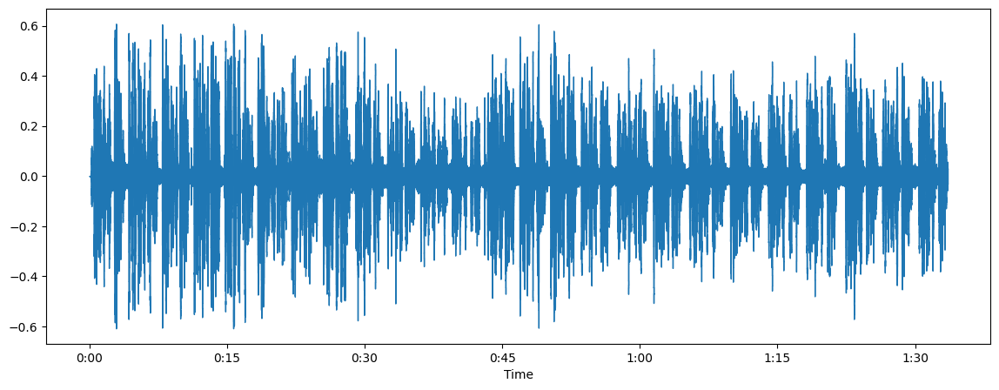

In [29]:
import librosa
import librosa.display
import IPython.display as ipd


file = '/Users/mudi/voice-model/data/Benign/Annu-26-f-normal /annu.mp3'
audio, sr = librosa.load(file)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
ipd.Audio(filename=file)

ffmpeg version 8.0 Copyright (c) 2000-2025 the FFmpeg developers
  built with Apple clang version 17.0.0 (clang-1700.3.19.1)
  configuration: --prefix=/opt/homebrew/Cellar/ffmpeg/8.0_1 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags= --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --enable-libsoxr --e

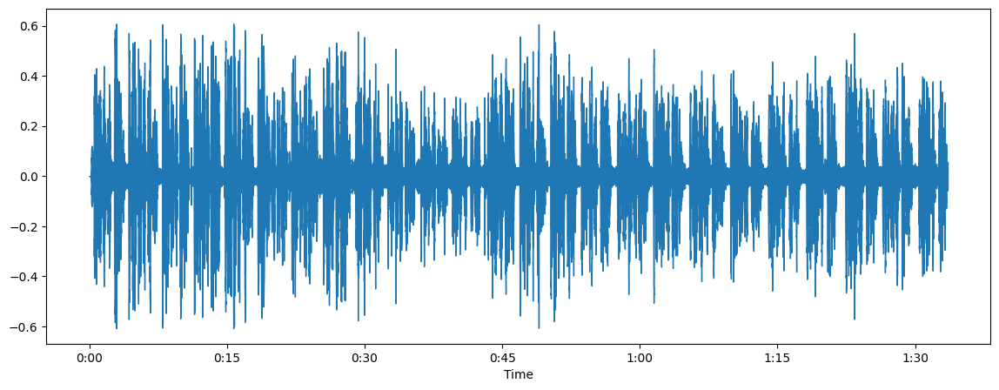

In [ ]:
import subprocess
import soundfile as sf

file

wav_file = file.replace('.mp3', '.wav')
subprocess.run(['ffmpeg', '-i', file, wav_file], check=True)

audio, sr = librosa.load(wav_file)

plt.figure(figsize=(14, 5))
librosa.display.waveshow(audio, sr=sr)
ipd.Audio(filename=wav_file)

(2063351,)
61
chunk length:  66150


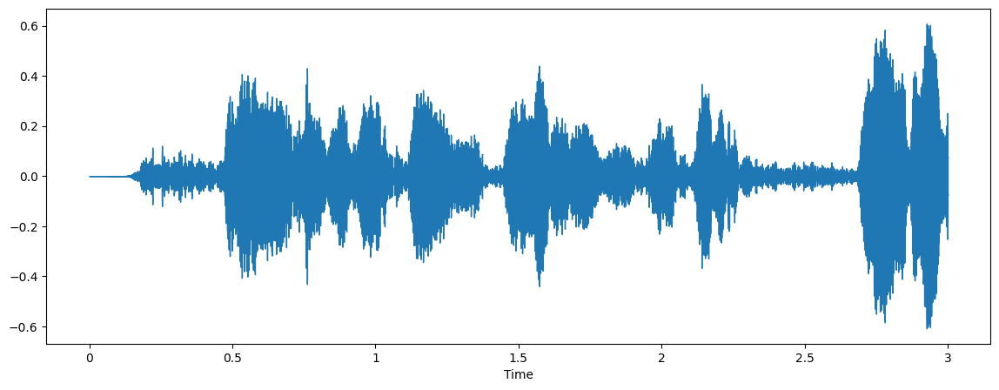

In [38]:
# chunking audio

def chunk_audio(audio, sr, duration, overlap_ratio):
        chunk_len = int(sr * duration)
        hop_len = int(chunk_len * (1 - overlap_ratio))

        chunks = []
        for start_idx in range(0, len(audio) - chunk_len + 1, hop_len):
            end_idx = start_idx + chunk_len
            chunk = audio[start_idx:end_idx]
            # ignore chunk if it has low energy (low RMS value)
            chunks.append(chunk)
        return chunks

print(audio.shape)

# 3 second chunks with 50% overlap
chunks = chunk_audio(audio, sr, 3, 0.5)
print(len(chunks))

print("chunk length: ", len(chunks[0]))

plt.figure(figsize=(14, 5))
librosa.display.waveshow(chunks[0], sr=sr)
ipd.Audio(data=chunks[0], rate=sr)






In [39]:
ipd.Audio(data=chunks[1], rate=sr)